# CycleGAN - Pytorch - Style Transfer

# I'm Something of a Painter Myself
Image-to-image translation has been an increasingly popular topic over the last years. One example of such a task is art style transfer. Style transfer algorithms in the context of art try to capture the general style of an artist or an image and apply it to one or many content pictures. As an example, think of your latest holiday picture and try to imagine how Monet or Van Gogh would have painted the scene. 

There are several different structures that try to do this task. One of the main differences is whether the style and content picture(s) are paired. A great paper to read to get started with style transfer is [Gatys et al. (2016)](https://openaccess.thecvf.com/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf). In the below notebook I apply a CycleGAN for unpaired image-to-image translation. I recommend to look at the original paper by [Zhu et al.](https://arxiv.org/abs/1703.10593). We will train train a model to transform an image from domain X (photo_jpg) into an image that looks like it came from domain Y (monet_jpg). 

Even though I have played around with similar structures during some courses I am still quite new to image applications. Throughout the notebook I amended code bits of a [Udacity Cycle GAN](https://github.com/udacity/deep-learning-v2-pytorch/tree/master/cycle-gan) exercise that I did a while ago. I am looking forward to receive constructive feedback on the notebook. 

## Introduction and set-up

Import all relevant packages and create paths.

In [1]:
# basic packages
import numpy as np
import pandas as pd
import scipy
import pickle
import random
import os

# loading in and transforming data
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torchvision.utils import make_grid
import PIL
from PIL import Image
import imageio

# visualizing data
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [2]:
# Paths et cetera
path_save_up_to_5gb = '/kaggle/working/'
path_monet = '../input/gan-getting-started/monet_jpg/'
path_photo = '../input/gan-getting-started/photo_jpg/'
img_size = 256

In [3]:
# #running this will list all files under the input directory
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))
# for dirname, _, filenames in os.walk('/kaggle/working'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# Seed

Fixing the seed makes it easier to reproduce the results.

In [4]:
def set_seed(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True

In [5]:
set_seed(42)

# Save and load

In [6]:
def save_checkpoint(iteration, G_XtoY, G_YtoX, D_X, D_Y, checkpoint_dir='/kaggle/working/'):
    """
    Saves the parameters of both generators and discriminators.
    """
    #Path
    G_XtoY_path = os.path.join(checkpoint_dir, 'G_XtoY.pkl')
    G_YtoX_path = os.path.join(checkpoint_dir, 'G_YtoX.pkl')
    D_X_path = os.path.join(checkpoint_dir, 'D_X.pkl')
    D_Y_path = os.path.join(checkpoint_dir, 'D_Y.pkl')
    #Saving
    torch.save(G_XtoY.state_dict(), G_XtoY_path)
    torch.save(G_YtoX.state_dict(), G_YtoX_path)
    torch.save(D_X.state_dict(), D_X_path)
    torch.save(D_Y.state_dict(), D_Y_path)

In [7]:
def load_checkpoint(checkpoint_path, map_location=None):
    """
    Load checkoint
    """
    #model.load_state_dict(torch.load(checkpoint_path))
    checkpoint = torch.load(checkpoint_path, map_location=map_location)
    print(' [*] Loading checkpoint from %s succeed!' % checkpoint_path)
    return checkpoint

In [8]:
def show_test(fixed_Y, fixed_X, G_YtoX, G_XtoY, mean_=0.5, std_=0.5):
    """
    Shows results of generates based on test image input. 
    """
    #Identify correct device
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    
    #Create fake pictures for both cycles
    fake_X = G_YtoX(fixed_Y.to(device))
    fake_Y = G_XtoY(fixed_X.to(device))
    
    #Generate grids
    grid_x =  make_grid(fixed_X, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    grid_y =  make_grid(fixed_Y, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    grid_fake_x =  make_grid(fake_X, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    grid_fake_y =  make_grid(fake_Y, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    
    #Normalize pictures to pixel range rom 0 to 255
    X, fake_X = reverse_normalize(grid_x, mean_, std_), reverse_normalize(grid_fake_x, mean_, std_)
    Y, fake_Y = reverse_normalize(grid_y, mean_, std_), reverse_normalize(grid_fake_y, mean_, std_)
    
    #Transformation from X -> Y
    fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, sharey=True, figsize=(20, 10))
    ax1.imshow(X)
    ax1.axis('off')
    ax1.set_title('X')
    ax2.imshow(fake_Y)
    ax2.axis('off')
    ax2.set_title('Fake Y  (Monet-esque)')
    plt.show()

# Datasets & dataloaders

Pytorch has some powerful dataloaders that make working with data much easier. To use the dataloader one first needs to create a dataset. Pytorch has some good [tutorials](https://pytorch.org/tutorials/beginner/data_loading_tutorial.html) on how to get started with this. The transformation can be structured as a class of its own. However, in the below I decided to implement it directly in the Dataset.

In [9]:
 class ImageDataset(Dataset):
        """
        Custom dataset
        """
        
        def __init__(self, img_path, img_size=256, normalize=True):
            self.img_path = img_path
            
            if normalize:
                self.transform = transforms.Compose([
                    transforms.Resize(img_size),
                    transforms.ToTensor(),
                    transforms.Normalize(mean=[0.5], std=[0.5])
                ])
            else:
                self.transform = transforms.Compose([
                    transforms.Resize(img_size),
                    transforms.ToTensor()
                ])
            
            #Dictionary entries
            self.img_idx = dict()
            for number_, img_ in enumerate(os.listdir(self.img_path)):
                self.img_idx[number_] = img_
                
        def __len__(self):
            #Length of dataset --> number of images
            return len(self.img_idx)
        
        def __getitem__(self, idx):
            img_path = os.path.join(self.img_path, self.img_idx[idx])
            img = Image.open(img_path)
            img = self.transform(img)
            
            return img

In [10]:
def reverse_normalize(image, mean_=0.5, std_=0.5):
    if torch.is_tensor(image):
        image = image.detach().numpy()
    un_normalized_img = image * std_ + mean_
    un_normalized_img = un_normalized_img * 255
    return np.uint8(un_normalized_img)

In [11]:
#Create datasets
dataset_monet = ImageDataset(path_monet, img_size=256, normalize=True) #monet
dataset_photo = ImageDataset(path_photo, img_size=256, normalize=True) #photo

In [12]:
#Create test loaders
batch_size_test = 8
batch_size=16
test_dataloader_Y = DataLoader(dataset_monet, batch_size=batch_size_test, shuffle=False, num_workers=0, pin_memory=True)
test_dataloader_X = DataLoader(dataset_photo, batch_size=batch_size_test, shuffle=False, num_workers=0, pin_memory=True)
dataloader_Y = DataLoader(dataset_monet, batch_size=batch_size, shuffle=True, num_workers=0, pin_memory=True)
dataloader_X = DataLoader(dataset_photo, batch_size=batch_size, shuffle=True, num_workers=0, pin_memory=True)

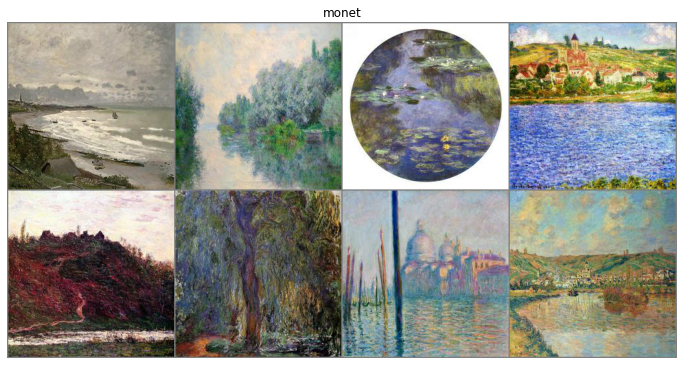

In [13]:
#Check dataset & dataloader results
dataiter = iter(test_dataloader_Y)
images_normalized = dataiter.next()
grid_normalized = make_grid(images_normalized, nrow=4).permute(1, 2, 0).detach().numpy()
grid_original = reverse_normalize(grid_normalized)
fig = plt.figure(figsize=(12, 8))
plt.imshow(grid_original)
plt.axis('off')
plt.title('monet')
plt.show()

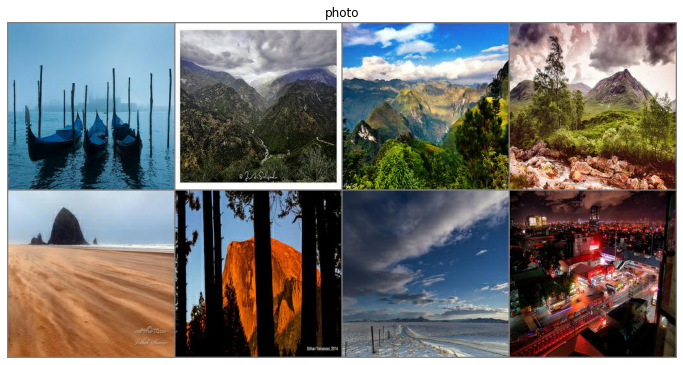

In [14]:
#Check dataset & dataloader results
dataiter = iter(test_dataloader_X)
images_normalized = dataiter.next()
grid_normalized = make_grid(images_normalized, nrow=4).permute(1, 2, 0).detach().numpy()
grid_original = reverse_normalize(grid_normalized)
fig = plt.figure(figsize=(12, 8))
plt.imshow(grid_original)
plt.axis('off')
plt.title('photo')
plt.show()

# Model

## Discriminator
The adversarial discriminators $D_X$ and $D_Y$ in our model are CNNs that see an image and try to classify it as real of fake. Real images are classified with an output close to 1 while fake classifications have an output close to 0. $D_Y$ encourages and classifies the transformation from domain X to Y (making photos into monet pictures). $D_X$ represents transformation classification from domain Y to X. 

We start out by creating a helper function that creates a convolutional layer, with optional batch or instance normalization. 
__Batch normalization__ was initially believed to improve deep learning models by reducing the "internal covariate shift" as proposed by [Ioffe and Szegedy (2015)](https://arxiv.org/pdf/1502.03167.pdf%20http://arxiv.org/abs/1502.03167.pdf). However, other papers such as by [Santurkar et al (2019)](https://arxiv.org/pdf/1805.11604.pdf) claim that the main advantage of using batch normalization is an improvement in the smoothness of the optimization landscape. 
__Instance normalization__ is a similar method that seems to work particularly well for style transfer, which is why we will use it in the below implementation. More information can be found in [Ulyanov and Vedaldi (2017)](https://arxiv.org/pdf/1607.08022.pdf).

In [15]:
import torch.nn as nn
import torch.nn.functional as F

def conv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=False, instance_norm=False):
    """
    Creates a convolutional layer, with optional batch / instance normalization. 
    """
    
    #Add layers
    layers = []
    conv_layer = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding, bias=False)
    layers.append(conv_layer)
    
    #Batch normalization
    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))
    
    #Instance normalization
    if instance_norm:
        layers.append(nn.InstanceNorm2d(out_channels))
    return nn.Sequential(*layers)

Next we construct the discriminator class. We will use the "raw" output as we will use a mean squared error loss. 

In [16]:
class Discriminator(nn.Module):
    
    def __init__(self, conv_dim=64):
        super(Discriminator, self).__init__()
        """
        Input is RGB image (256x256x3) while output is a single value
        
        determine size = [(W−K+2P)/S]+1
        W: input=256
        K: kernel_size=4
        P: padding=1
        S: stride=2
        """
        
        #convolutional layers, increasing in depth
        self.conv1 = conv(in_channels=3, out_channels=conv_dim, kernel_size=4) # (128, 128, 64)
        self.conv2 = conv(in_channels=conv_dim, out_channels=conv_dim*2, kernel_size=4, instance_norm=True) # (64, 64, 128)
        self.conv3 = conv(in_channels=conv_dim*2, out_channels=conv_dim*4, kernel_size=4, instance_norm=True) # (32, 32, 256)
        self.conv4 = conv(in_channels=conv_dim*4, out_channels=conv_dim*8, kernel_size=4, instance_norm=True) # (16, 16, 512)
        self.conv5 = conv(in_channels=conv_dim*8, out_channels=conv_dim*8, kernel_size=4, batch_norm=True) # (8, 8, 512)
        
        #final classification layer
        self.conv6 = conv(conv_dim*8, out_channels=1, kernel_size=4, stride=1) # (8, 8, 1)
    
    def forward(self, x):
        
        #leaky relu applied to all conv layers but last
        out = F.leaky_relu(self.conv1(x), negative_slope=0.2)
        out = F.leaky_relu(self.conv2(out), negative_slope=0.2)
        out = F.leaky_relu(self.conv3(out), negative_slope=0.2)
        out = F.leaky_relu(self.conv4(out), negative_slope=0.2)
#         out = F.leaky_relu(self.conv5(out), negative_slope=0.2)
        
        #classification layer (--> depending on the loss function we might want to use an activation function here, e.g. sigmoid)
        out = self.conv6(out)
        return out

## Generator
We have two generators (G_XtoY and G_YtoX). They each consist of 
* encoder (compressing the image into a smaller feature representation), 
* residual blocks (connecting the output of one layer with the input of an earlier layer) and 
* decoder (turning compressed representation into a transformed image). <br>

If you want to know more about the residual blocks have a look at [He et al. (2015)](https://arxiv.org/pdf/1512.03385.pdf). Here we only design 1 residual block. The generator will have a parameter that allows to repeat this component multiple times.

In [17]:
class ResidualBlock(nn.Module):

    def __init__(self, conv_dim):
        super(ResidualBlock, self).__init__()
        """
        Residual blocks help the model to effectively learn the transformation from one domain to another. 
        """
        self.conv1 = conv(in_channels=conv_dim, out_channels=conv_dim, kernel_size=3, stride=1, padding=1, instance_norm=True)
        self.conv2 = conv(in_channels=conv_dim, out_channels=conv_dim, kernel_size=3, stride=1, padding=1, instance_norm=True)
        
    def forward(self, x):
        out_1 = F.relu(self.conv1(x))
        out_2 = x + self.conv2(out_1)
        return out_2

In [18]:
def deconv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=False, instance_norm=False, dropout=False, dropout_ratio=0.5):
    """
    Creates a transpose convolutional layer, with optional batch / instance normalization. Select either batch OR instance normalization. 
    """
    
    #Add layers
    layers = []
    layers.append(nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False))
    
    #Batch normalization
    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))
    
    #Instance normalization
    if instance_norm:
        layers.append(nn.InstanceNorm2d(out_channels))
    
    #Dropout
    if dropout:
        layers.append(nn.Dropout2d(dropout_ratio))
    
    return nn.Sequential(*layers)

In [19]:
class CycleGenerator(nn.Module):
    
    def __init__(self, conv_dim=64, n_res_blocks=6):
        super(CycleGenerator, self).__init__()
        """
        Input is RGB image (256x256x3) while output is a single value
        
        determine size = [(W−K+2P)/S]+1
        W: input=256
        K: kernel_size=4
        P: padding=1
        S: stride=2
        """
        
        #Encoder layers
        self.conv1 = conv(in_channels=3, out_channels=conv_dim, kernel_size=4) # (128, 128, 64)
        self.conv2 = conv(in_channels=conv_dim, out_channels=conv_dim*2, kernel_size=4, instance_norm=True) # (64, 64, 128)
        self.conv3 = conv(in_channels=conv_dim*2, out_channels=conv_dim*4, kernel_size=4, instance_norm=True) # (32, 32, 256)
        
        #Residual blocks (number depends on input parameter)
        res_layers = []
        for layer in range(n_res_blocks):
            res_layers.append(ResidualBlock(conv_dim*4))
        self.res_blocks = nn.Sequential(*res_layers)
        
        #Decoder layers
        self.deconv4 = deconv(in_channels=conv_dim*4, out_channels=conv_dim*2, kernel_size=4, instance_norm=True) # (64, 64, 128)
        self.deconv5 = deconv(in_channels=conv_dim*2, out_channels=conv_dim, kernel_size=4, instance_norm=True) # (128, 128, 64)
        self.deconv6 = deconv(in_channels=conv_dim, out_channels=3, kernel_size=4, instance_norm=True) # (256, 256, 3)
        
    def forward(self, x):
        """
        Given an image x, returns a transformed image.
        """
        
        #Encoder
        out = F.leaky_relu(self.conv1(x), negative_slope=0.2) # (128, 128, 64)
        out = F.leaky_relu(self.conv2(out), negative_slope=0.2) # (64, 64, 128)
        out = F.leaky_relu(self.conv3(out), negative_slope=0.2) # (32, 32, 256)
        
        #Residual blocks
        out = self.res_blocks(out)
        
        #Decoder
        out = F.leaky_relu(self.deconv4(out), negative_slope=0.2) # (64, 64, 128)
        out = F.leaky_relu(self.deconv5(out), negative_slope=0.2) # (128, 128, 64)
        out = torch.tanh(self.deconv6(out)) # (256, 256, 3)
        
        return out

In [20]:
from torch.nn import init
def weights_init_normal(m):
    """
    Applies initial weights to certain layers in a model.
    The weights are taken from a normal distribution with mean = 0, std dev = 0.02.
    Param m: A module or layer in a network    
    """
    #classname will be something like: `Conv`, `BatchNorm2d`, `Linear`, etc.
    classname = m.__class__.__name__
    
    #normal distribution with given paramters
    std_dev = 0.02
    mean = 0.0
    
    # Initialize conv layer
    if hasattr(m, 'weight') and (classname.find('Conv') != -1):
        init.normal_(m.weight.data, mean, std_dev)

In [21]:
def build_model(g_conv_dim=64, d_conv_dim=64, n_res_blocks=6):
    """
    Builds generators G_XtoY & G_YtoX and discriminators D_X & D_Y 
    """
    
    #Generators
    G_XtoY = CycleGenerator(conv_dim=g_conv_dim, n_res_blocks=n_res_blocks)
    G_YtoX = CycleGenerator(conv_dim=g_conv_dim, n_res_blocks=n_res_blocks)
    
    #Discriminators
    D_X = Discriminator(conv_dim=d_conv_dim) # Y-->X
    D_Y = Discriminator(conv_dim=d_conv_dim) # X-->Y
    
    #Weight initialization
    G_XtoY.apply(weights_init_normal)
    G_YtoX.apply(weights_init_normal)
    D_X.apply(weights_init_normal)
    D_Y.apply(weights_init_normal)
    
    #Moves models to GPU, if available
    if torch.cuda.is_available():
        device = torch.device("cuda:0")
        G_XtoY.to(device)
        G_YtoX.to(device)
        D_X.to(device)
        D_Y.to(device)
        print('Models moved to GPU.')
    else:
        print('Only CPU available.')

    return G_XtoY, G_YtoX, D_X, D_Y

In [22]:
#Function call
G_XtoY, G_YtoX, D_X, D_Y = build_model()

Models moved to GPU.


In [23]:
#Check model structure
def print_build(G_XtoY, G_YtoX, D_X, D_Y):
    print("                     G_XtoY                    ")
    print("-----------------------------------------------")
    print(G_XtoY)
    print()

    print("                     G_YtoX                    ")
    print("-----------------------------------------------")
    print(G_YtoX)
    print()

    print("                      D_X                      ")
    print("-----------------------------------------------")
    print(D_X)
    print()

    print("                      D_Y                      ")
    print("-----------------------------------------------")
    print(D_Y)
    print()
    
print_build(G_XtoY, G_YtoX, D_X, D_Y)

                     G_XtoY                    
-----------------------------------------------
CycleGenerator(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (res_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      )
      (conv2): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3)

## Loss function

### Adversarial loss
As mentioned earlier we have two discriminator losses. The loss for both functions will be the mean squared error between the output of the respective discriminator and the target value (either 1 or 0). In the code this is implemented via real_mse_loss and fake_mse_loss. 

### Cycle consistency loss
Forward cycle-consistency loss from X->Y->X. Backward cycle-consistency loss from Y->X->Y. 

### Identity loss
Forward identity loss X->Y. Backward identity loss from Y->X.

In [24]:
def real_mse_loss(D_out, adverserial_weight=1):
    #how close is the produced output from being "real"?
    mse_loss = torch.mean((D_out-1)**2)*adverserial_weight
    return mse_loss

def fake_mse_loss(D_out, adverserial_weight=1):
    #how close is the produced output from being "false"?
    mse_loss = torch.mean(D_out**2)*adverserial_weight
    return mse_loss

def cycle_consistency_loss(real_img, reconstructed_img, lambda_weight=1):
    reconstr_loss = torch.mean(torch.abs(real_img - reconstructed_img))
    return lambda_weight*reconstr_loss 

def identity_loss(real_img, generated_img, identity_weight=1):
    ident_loss = torch.mean(torch.abs(real_img - generated_img))
    return identity_weight*ident_loss

# Optimizers

In [25]:
import torch.optim as optim

#hyperparameter
lr=0.0002 #0.0002
beta1=0.500 #exponential decay rate for the first moment estimates
beta2=0.999 #exponential decay rate for the second-moment estimates
g_params = list(G_XtoY.parameters()) + list(G_YtoX.parameters())

#Optimizers for generator and discriminator
g_optimizer = optim.Adam(g_params, lr, [beta1, beta2])
d_x_optimizer = optim.Adam(D_X.parameters(), lr, [beta1, beta2])
d_y_optimizer = optim.Adam(D_Y.parameters(), lr, [beta1, beta2])

# Training

In [26]:
def training_loop(dataloader_X, dataloader_Y, test_dataloader_X, test_dataloader_Y, n_epochs=1000):
    
    #Losses over time
    losses = []
    
    #Additional weighting parameters (in reality only 2 are required as the third is kind of "given relatively" by the other two)
    adverserial_weight = 0.5
    lambda_weight = 10
    identity_weight = 5
    
    #Get some fixed data from domains X and Y for sampling. Images are held constant throughout training and allow us to inspect the model's performance.
    test_iter_X = iter(test_dataloader_X)
    test_iter_Y = iter(test_dataloader_Y)
    fixed_X = test_iter_X.next()
    fixed_Y = test_iter_Y.next()
    
    # batches per epoch
    iter_X = iter(dataloader_X)
    iter_Y = iter(dataloader_Y)
    batches_per_epoch = min(len(iter_X), len(iter_Y))
    
    #Average loss over batches per epoch runs
    d_total_loss_avg = 0.0
    g_total_loss_avg = 0.0
    
    #Loop through epochs
    for epoch in range(1, n_epochs+1):
        
        #reset iterators for each epoch
        if epoch % batches_per_epoch == 0:
            iter_X = iter(dataloader_X)
            iter_Y = iter(dataloader_Y)
        
        #Get images from domain X
        images_X = iter_X.next()
        
        #Get images from domain Y
        images_Y = iter_Y.next()
        
        #move images to GPU if available (otherwise stay on CPU)
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        images_X = images_X.to(device)
        images_Y = images_Y.to(device)
        
        
        # ============================================
        #            TRAIN THE DISCRIMINATORS
        # ============================================
        
        
        # --------------------------------------------
        ## First: D_X, real and fake loss components
        # --------------------------------------------
        
        # Train with real images
        d_x_optimizer.zero_grad()
        
        # 1. Compute the discriminator losses on real images
        out_x = D_X(images_X)
        D_X_real_loss = real_mse_loss(out_x, adverserial_weight)
        
        # Train with fake images
        # 2. Generate fake images that look like domain X based on real images in domain Y
        fake_X = G_YtoX(images_Y)

        # 3. Compute the fake loss for D_X
        out_x = D_X(fake_X)
        D_X_fake_loss = fake_mse_loss(out_x, adverserial_weight)
        
        # 4. Compute the total loss and perform backpropagation
        d_x_loss = D_X_real_loss + D_X_fake_loss
        d_x_loss.backward()
        d_x_optimizer.step()
        
        # --------------------------------------------
        ## Second: D_Y, real and fake loss components
        # --------------------------------------------
        
        # Train with real images
        d_y_optimizer.zero_grad()
        
        # 1. Compute the discriminator losses on real images
        out_y = D_Y(images_Y)
        D_Y_real_loss = real_mse_loss(out_y, adverserial_weight)
        
        # Train with fake images
        # 2. Generate fake images that look like domain Y based on real images in domain X
        fake_Y = G_XtoY(images_X)
        
        # 3. Compute the fake loss for D_Y
        out_y = D_Y(fake_Y)
        D_Y_fake_loss = fake_mse_loss(out_y, adverserial_weight)
        
        # 4. Compute the total loss and perform backprop
        d_y_loss = D_Y_real_loss + D_Y_fake_loss
        d_y_loss.backward()
        d_y_optimizer.step()
        
        # 5. Compute total discriminator loss
        d_total_loss = D_X_real_loss + D_X_fake_loss + D_Y_real_loss + D_Y_fake_loss
        

        # =========================================
        #            TRAIN THE GENERATORS
        # =========================================
        
        
        # --------------------------------------------
        ## First: generate fake X images and reconstructed Y images
        # --------------------------------------------
        
        #Back to the start
        g_optimizer.zero_grad()
        
        # 1. Generate fake images that look like domain X based on real images in domain Y
        fake_X = G_YtoX(images_Y)
        
        # 2. Compute the generator loss based on domain X
        out_x = D_X(fake_X)
        g_YtoX_loss = real_mse_loss(out_x, adverserial_weight)

        # 3. Create a reconstructed y
        reconstructed_Y = G_XtoY(fake_X)
        
        # 4. Compute the cycle consistency loss (the reconstruction loss)
        reconstructed_y_loss = cycle_consistency_loss(images_Y, reconstructed_Y, lambda_weight=lambda_weight)
        
        # 5. Compute the identity loss from transformation Y-->X
        identity_y_loss = identity_loss(images_Y, fake_X, identity_weight=identity_weight)
        
        # --------------------------------------------
        ## Second: generate fake Y images and reconstructed X images
        # --------------------------------------------
        
        # 1. Generate fake images that look like domain Y based on real images in domain X
        fake_Y = G_XtoY(images_X)
        
        # 2. Compute the generator loss based on domain Y
        out_y = D_Y(fake_Y) #if discriminator believes picture to be from domain Y it returns values cloer to 1, else closer to 0
        g_XtoY_loss = real_mse_loss(out_y, adverserial_weight)
        
        # 3. Create a reconstructed x
        reconstructed_X = G_YtoX(fake_Y)
        
        # 4. Compute the cycle consistency loss (the reconstruction loss)
        reconstructed_x_loss = cycle_consistency_loss(images_X, reconstructed_X, lambda_weight=lambda_weight)
        
        # 5. Compute the identity loss from transformation X-->Y
        identity_x_loss = identity_loss(images_X, fake_Y, identity_weight=identity_weight)
        
        # 6. Add up all generator and reconstructed losses and perform backprop
        g_total_loss = g_YtoX_loss + g_XtoY_loss + reconstructed_y_loss + reconstructed_x_loss + identity_y_loss + identity_x_loss
        g_total_loss.backward()
        g_optimizer.step()
        
        
        # =========================================
        # Admin 
        # =========================================
        
        
        #Average loss
        d_total_loss_avg = d_total_loss_avg + d_total_loss / batches_per_epoch
        g_total_loss_avg = g_total_loss_avg + g_total_loss / batches_per_epoch
        
        # Print log info
        print_every = batches_per_epoch
        if epoch % print_every == 0:
            # append real and fake discriminator losses and the generator loss
            losses.append((d_total_loss_avg.item(), g_total_loss_avg.item()))
            true_epoch_n = int(epoch/batches_per_epoch)
            true_epoch_total = int(n_epochs/batches_per_epoch)
            print('Epoch [{:5d}/{:5d}] | d_total_loss_avg: {:6.4f} | g_total_loss: {:6.4f}'.format(
                    true_epoch_n, true_epoch_total, d_total_loss_avg.item(), g_total_loss_avg.item()))
        
        #Show the generated samples
        show_every = (batches_per_epoch*10)
        if epoch % show_every == 0:
            #set generators to eval mode for image generation
            G_YtoX.eval()
            G_XtoY.eval()
            test_images = show_test(fixed_Y, fixed_X, G_YtoX, G_XtoY)
            #set generators to train mode to continue training
            G_YtoX.train()
            G_XtoY.train()
        
#         #save the model parameters
#         checkpoint_every=3000
#         if epoch % checkpoint_every == 0:
#             save_checkpoint(epoch, G_XtoY, G_YtoX, D_X, D_Y)
    
        #reset average loss for each epoch
        if epoch % batches_per_epoch == 0:
            d_total_loss_avg = 0.0
            g_total_loss_avg = 0.0
    
    return losses

Due to the implementation of the loop there is no "real" differenciation between epoch and batch. We calculate it below.

In [27]:
batches_per_epoch = min(len(dataloader_X), len(dataloader_Y))
epoch_true = 256

Epoch [    1/  256] | d_total_loss_avg: 4.3146 | g_total_loss: 17.6644
Epoch [    2/  256] | d_total_loss_avg: 1.2467 | g_total_loss: 11.4346
Epoch [    3/  256] | d_total_loss_avg: 0.6458 | g_total_loss: 10.3354
Epoch [    4/  256] | d_total_loss_avg: 0.5485 | g_total_loss: 9.9745
Epoch [    5/  256] | d_total_loss_avg: 0.5583 | g_total_loss: 9.5069
Epoch [    6/  256] | d_total_loss_avg: 0.5202 | g_total_loss: 9.3480
Epoch [    7/  256] | d_total_loss_avg: 0.4883 | g_total_loss: 9.2294
Epoch [    8/  256] | d_total_loss_avg: 0.4245 | g_total_loss: 8.9680
Epoch [    9/  256] | d_total_loss_avg: 0.5539 | g_total_loss: 8.7083
Epoch [   10/  256] | d_total_loss_avg: 0.3944 | g_total_loss: 8.3505


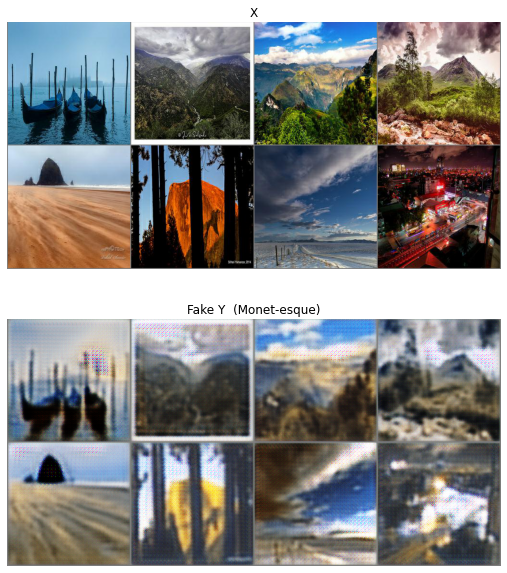

Epoch [   11/  256] | d_total_loss_avg: 0.4334 | g_total_loss: 8.4162
Epoch [   12/  256] | d_total_loss_avg: 0.4151 | g_total_loss: 8.0999
Epoch [   13/  256] | d_total_loss_avg: 0.3893 | g_total_loss: 8.2425
Epoch [   14/  256] | d_total_loss_avg: 0.3758 | g_total_loss: 8.0726
Epoch [   15/  256] | d_total_loss_avg: 0.3635 | g_total_loss: 8.1973
Epoch [   16/  256] | d_total_loss_avg: 0.3910 | g_total_loss: 7.9323
Epoch [   17/  256] | d_total_loss_avg: 0.3340 | g_total_loss: 7.8238
Epoch [   18/  256] | d_total_loss_avg: 0.3968 | g_total_loss: 7.9809
Epoch [   19/  256] | d_total_loss_avg: 0.3698 | g_total_loss: 7.8588
Epoch [   20/  256] | d_total_loss_avg: 0.3073 | g_total_loss: 7.8851


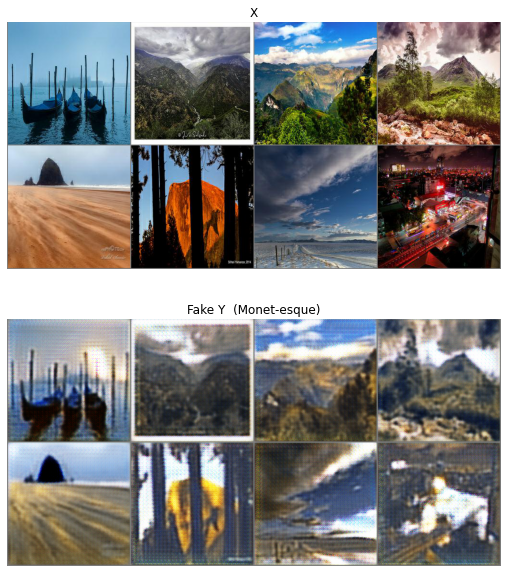

Epoch [   21/  256] | d_total_loss_avg: 0.4349 | g_total_loss: 7.5984
Epoch [   22/  256] | d_total_loss_avg: 0.2979 | g_total_loss: 7.6558
Epoch [   23/  256] | d_total_loss_avg: 0.3621 | g_total_loss: 7.6786
Epoch [   24/  256] | d_total_loss_avg: 0.3449 | g_total_loss: 7.7652
Epoch [   25/  256] | d_total_loss_avg: 0.3347 | g_total_loss: 7.7166
Epoch [   26/  256] | d_total_loss_avg: 0.2700 | g_total_loss: 7.5797
Epoch [   27/  256] | d_total_loss_avg: 0.3863 | g_total_loss: 7.6676
Epoch [   28/  256] | d_total_loss_avg: 0.2981 | g_total_loss: 7.4794
Epoch [   29/  256] | d_total_loss_avg: 0.3261 | g_total_loss: 7.6228
Epoch [   30/  256] | d_total_loss_avg: 0.3133 | g_total_loss: 7.3889


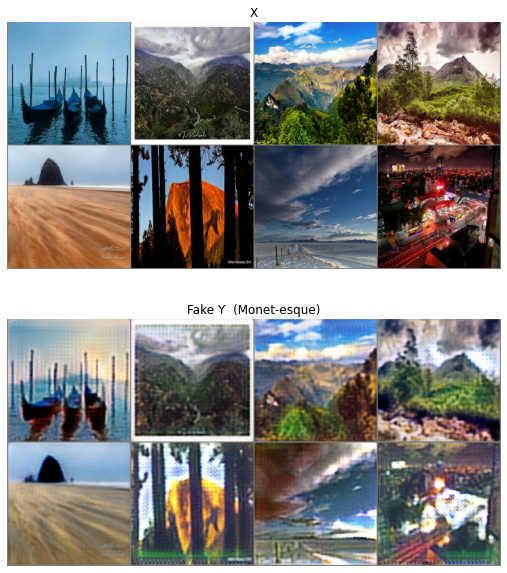

Epoch [   31/  256] | d_total_loss_avg: 0.3402 | g_total_loss: 7.5169
Epoch [   32/  256] | d_total_loss_avg: 0.2898 | g_total_loss: 7.3654
Epoch [   33/  256] | d_total_loss_avg: 0.3657 | g_total_loss: 7.7189
Epoch [   34/  256] | d_total_loss_avg: 0.2924 | g_total_loss: 7.5950
Epoch [   35/  256] | d_total_loss_avg: 0.3073 | g_total_loss: 7.4277
Epoch [   36/  256] | d_total_loss_avg: 0.3262 | g_total_loss: 7.3804
Epoch [   37/  256] | d_total_loss_avg: 0.2598 | g_total_loss: 7.2357
Epoch [   38/  256] | d_total_loss_avg: 0.2878 | g_total_loss: 7.4779
Epoch [   39/  256] | d_total_loss_avg: 0.3007 | g_total_loss: 7.4989
Epoch [   40/  256] | d_total_loss_avg: 0.3120 | g_total_loss: 7.4369


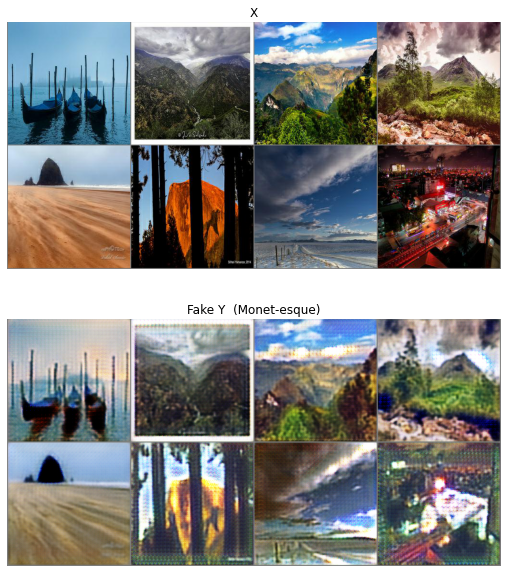

Epoch [   41/  256] | d_total_loss_avg: 0.2697 | g_total_loss: 7.3626
Epoch [   42/  256] | d_total_loss_avg: 0.2844 | g_total_loss: 7.2618
Epoch [   43/  256] | d_total_loss_avg: 0.3028 | g_total_loss: 7.3909
Epoch [   44/  256] | d_total_loss_avg: 0.2952 | g_total_loss: 7.4512
Epoch [   45/  256] | d_total_loss_avg: 0.2470 | g_total_loss: 7.4983
Epoch [   46/  256] | d_total_loss_avg: 0.2477 | g_total_loss: 7.3415
Epoch [   47/  256] | d_total_loss_avg: 0.3529 | g_total_loss: 7.2403
Epoch [   48/  256] | d_total_loss_avg: 0.2434 | g_total_loss: 7.1381
Epoch [   49/  256] | d_total_loss_avg: 0.2720 | g_total_loss: 7.2138
Epoch [   50/  256] | d_total_loss_avg: 0.2738 | g_total_loss: 7.6304


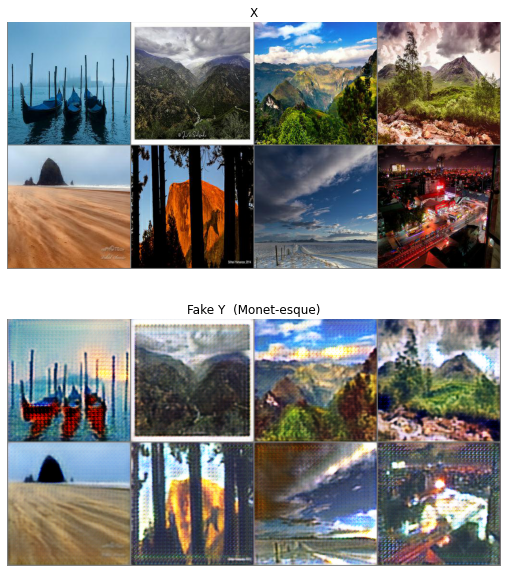

Epoch [   51/  256] | d_total_loss_avg: 0.2595 | g_total_loss: 7.4126
Epoch [   52/  256] | d_total_loss_avg: 0.2862 | g_total_loss: 7.1697
Epoch [   53/  256] | d_total_loss_avg: 0.3291 | g_total_loss: 7.3269
Epoch [   54/  256] | d_total_loss_avg: 0.2569 | g_total_loss: 7.1467
Epoch [   55/  256] | d_total_loss_avg: 0.2764 | g_total_loss: 7.3018
Epoch [   56/  256] | d_total_loss_avg: 0.2375 | g_total_loss: 7.1957
Epoch [   57/  256] | d_total_loss_avg: 0.2543 | g_total_loss: 7.2120
Epoch [   58/  256] | d_total_loss_avg: 0.2589 | g_total_loss: 7.2725
Epoch [   59/  256] | d_total_loss_avg: 0.2720 | g_total_loss: 7.0190
Epoch [   60/  256] | d_total_loss_avg: 0.2815 | g_total_loss: 7.2879


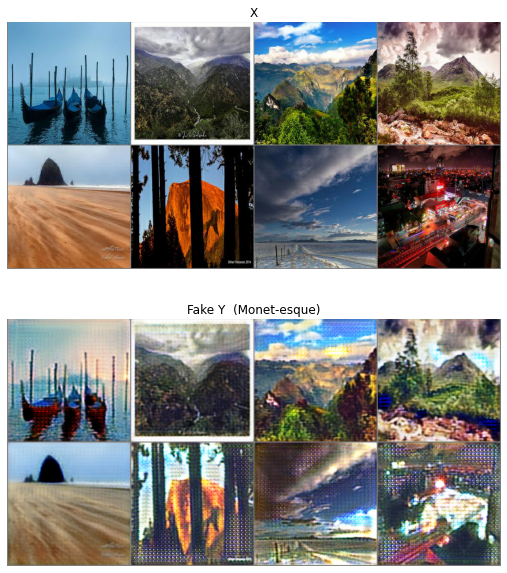

Epoch [   61/  256] | d_total_loss_avg: 0.2468 | g_total_loss: 7.1427
Epoch [   62/  256] | d_total_loss_avg: 0.2376 | g_total_loss: 7.2504
Epoch [   63/  256] | d_total_loss_avg: 0.2614 | g_total_loss: 7.1635
Epoch [   64/  256] | d_total_loss_avg: 0.2525 | g_total_loss: 7.1474
Epoch [   65/  256] | d_total_loss_avg: 0.2292 | g_total_loss: 7.2179
Epoch [   66/  256] | d_total_loss_avg: 0.2380 | g_total_loss: 6.9859
Epoch [   67/  256] | d_total_loss_avg: 0.3393 | g_total_loss: 7.1454
Epoch [   68/  256] | d_total_loss_avg: 0.1986 | g_total_loss: 7.0622
Epoch [   69/  256] | d_total_loss_avg: 0.2581 | g_total_loss: 7.0977
Epoch [   70/  256] | d_total_loss_avg: 0.2170 | g_total_loss: 7.1804


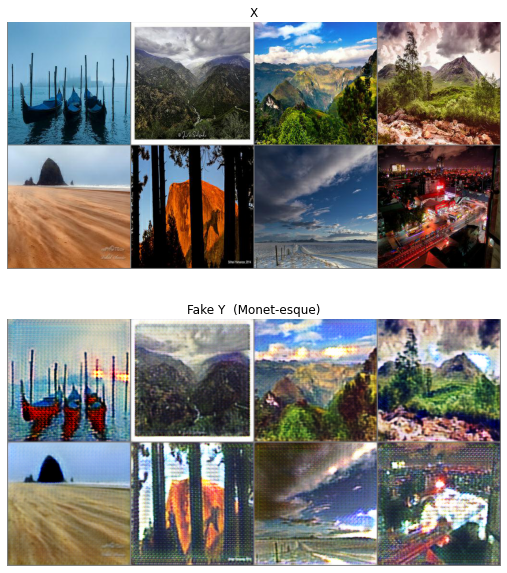

Epoch [   71/  256] | d_total_loss_avg: 0.2152 | g_total_loss: 7.2108
Epoch [   72/  256] | d_total_loss_avg: 0.2628 | g_total_loss: 7.1566
Epoch [   73/  256] | d_total_loss_avg: 0.2475 | g_total_loss: 7.1190
Epoch [   74/  256] | d_total_loss_avg: 0.2288 | g_total_loss: 6.9109
Epoch [   75/  256] | d_total_loss_avg: 0.2389 | g_total_loss: 7.0813
Epoch [   76/  256] | d_total_loss_avg: 0.1973 | g_total_loss: 7.0031
Epoch [   77/  256] | d_total_loss_avg: 0.2471 | g_total_loss: 7.0363
Epoch [   78/  256] | d_total_loss_avg: 0.2249 | g_total_loss: 7.1138
Epoch [   79/  256] | d_total_loss_avg: 0.2150 | g_total_loss: 7.1569
Epoch [   80/  256] | d_total_loss_avg: 0.2155 | g_total_loss: 7.0774


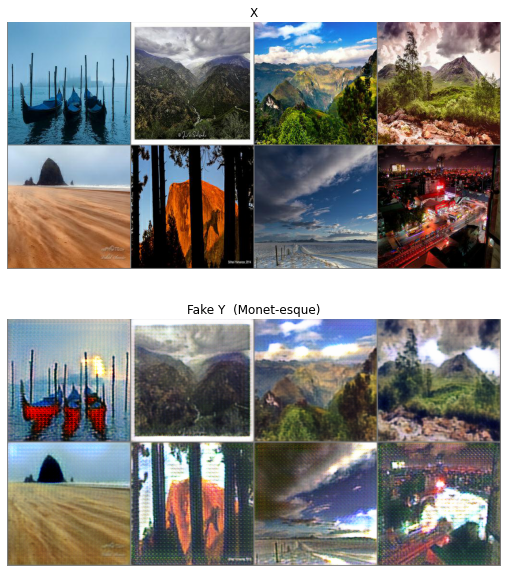

Epoch [   81/  256] | d_total_loss_avg: 0.1865 | g_total_loss: 7.3387
Epoch [   82/  256] | d_total_loss_avg: 0.1906 | g_total_loss: 7.0212
Epoch [   83/  256] | d_total_loss_avg: 0.3161 | g_total_loss: 7.0451
Epoch [   84/  256] | d_total_loss_avg: 0.1741 | g_total_loss: 7.0836
Epoch [   85/  256] | d_total_loss_avg: 0.1986 | g_total_loss: 7.2896
Epoch [   86/  256] | d_total_loss_avg: 0.2372 | g_total_loss: 7.0771
Epoch [   87/  256] | d_total_loss_avg: 0.1802 | g_total_loss: 6.9474
Epoch [   88/  256] | d_total_loss_avg: 0.2146 | g_total_loss: 7.0326
Epoch [   89/  256] | d_total_loss_avg: 0.2463 | g_total_loss: 7.0848
Epoch [   90/  256] | d_total_loss_avg: 0.1736 | g_total_loss: 6.9351


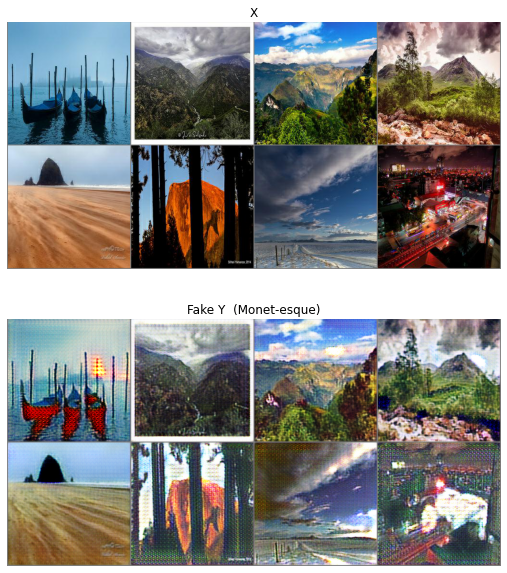

Epoch [   91/  256] | d_total_loss_avg: 0.2233 | g_total_loss: 6.8666
Epoch [   92/  256] | d_total_loss_avg: 0.2775 | g_total_loss: 6.8481
Epoch [   93/  256] | d_total_loss_avg: 0.1688 | g_total_loss: 7.1651
Epoch [   94/  256] | d_total_loss_avg: 0.1991 | g_total_loss: 6.8506
Epoch [   95/  256] | d_total_loss_avg: 0.2829 | g_total_loss: 6.9093
Epoch [   96/  256] | d_total_loss_avg: 0.1665 | g_total_loss: 6.9827
Epoch [   97/  256] | d_total_loss_avg: 0.2028 | g_total_loss: 6.9550
Epoch [   98/  256] | d_total_loss_avg: 0.1965 | g_total_loss: 6.8295
Epoch [   99/  256] | d_total_loss_avg: 0.1855 | g_total_loss: 6.8173
Epoch [  100/  256] | d_total_loss_avg: 0.1883 | g_total_loss: 6.8555


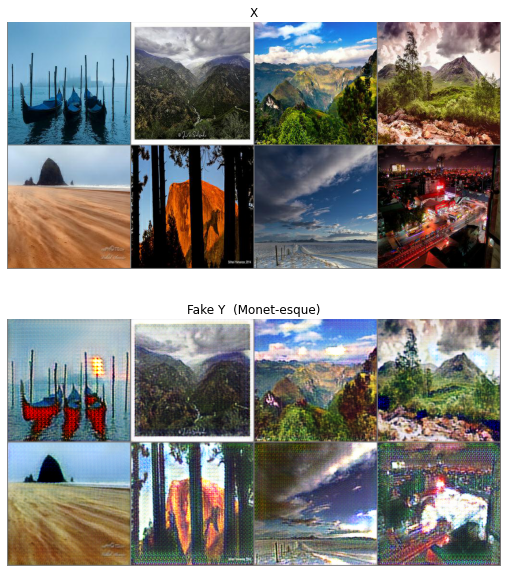

Epoch [  101/  256] | d_total_loss_avg: 0.2083 | g_total_loss: 6.9329
Epoch [  102/  256] | d_total_loss_avg: 0.2245 | g_total_loss: 6.8824
Epoch [  103/  256] | d_total_loss_avg: 0.1669 | g_total_loss: 6.9053
Epoch [  104/  256] | d_total_loss_avg: 0.2158 | g_total_loss: 6.8851
Epoch [  105/  256] | d_total_loss_avg: 0.1988 | g_total_loss: 7.0829
Epoch [  106/  256] | d_total_loss_avg: 0.2004 | g_total_loss: 7.0068
Epoch [  107/  256] | d_total_loss_avg: 0.1455 | g_total_loss: 6.7905
Epoch [  108/  256] | d_total_loss_avg: 0.2496 | g_total_loss: 6.8920
Epoch [  109/  256] | d_total_loss_avg: 0.2171 | g_total_loss: 6.9842
Epoch [  110/  256] | d_total_loss_avg: 0.1606 | g_total_loss: 6.8280


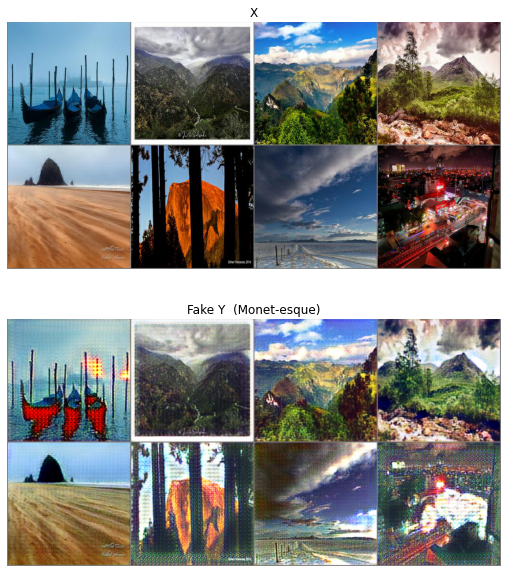

Epoch [  111/  256] | d_total_loss_avg: 0.1725 | g_total_loss: 6.7868
Epoch [  112/  256] | d_total_loss_avg: 0.2392 | g_total_loss: 6.7999
Epoch [  113/  256] | d_total_loss_avg: 0.1562 | g_total_loss: 6.8662
Epoch [  114/  256] | d_total_loss_avg: 0.1924 | g_total_loss: 6.9657
Epoch [  115/  256] | d_total_loss_avg: 0.1542 | g_total_loss: 6.9219
Epoch [  116/  256] | d_total_loss_avg: 0.1766 | g_total_loss: 6.8371
Epoch [  117/  256] | d_total_loss_avg: 0.2209 | g_total_loss: 6.7906
Epoch [  118/  256] | d_total_loss_avg: 0.1842 | g_total_loss: 6.7980
Epoch [  119/  256] | d_total_loss_avg: 0.1654 | g_total_loss: 6.8355
Epoch [  120/  256] | d_total_loss_avg: 0.2299 | g_total_loss: 6.9201


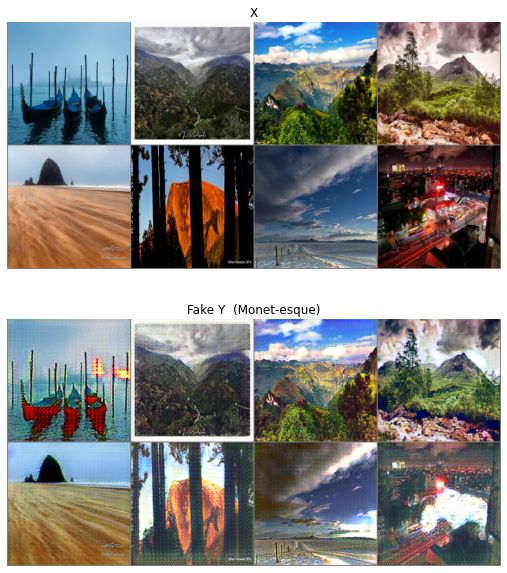

Epoch [  121/  256] | d_total_loss_avg: 0.1924 | g_total_loss: 6.7029
Epoch [  122/  256] | d_total_loss_avg: 0.1489 | g_total_loss: 6.6006
Epoch [  123/  256] | d_total_loss_avg: 0.1799 | g_total_loss: 6.7296
Epoch [  124/  256] | d_total_loss_avg: 0.1933 | g_total_loss: 6.8720
Epoch [  125/  256] | d_total_loss_avg: 0.1648 | g_total_loss: 6.7466
Epoch [  126/  256] | d_total_loss_avg: 0.1725 | g_total_loss: 6.9554
Epoch [  127/  256] | d_total_loss_avg: 0.1529 | g_total_loss: 6.8076
Epoch [  128/  256] | d_total_loss_avg: 0.1849 | g_total_loss: 6.8784
Epoch [  129/  256] | d_total_loss_avg: 0.2558 | g_total_loss: 6.6584
Epoch [  130/  256] | d_total_loss_avg: 0.1578 | g_total_loss: 6.7633


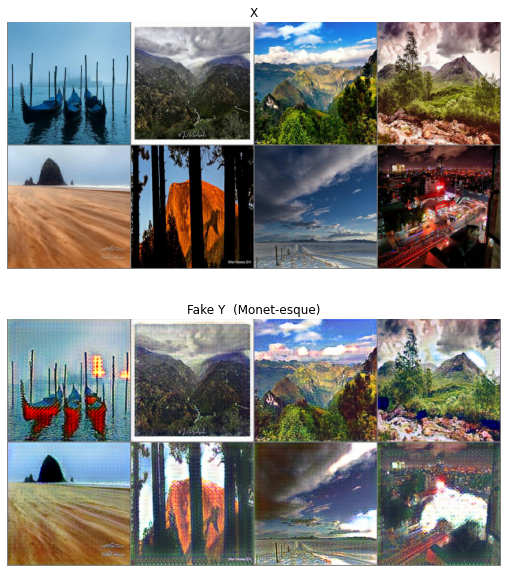

Epoch [  131/  256] | d_total_loss_avg: 0.1657 | g_total_loss: 6.8571
Epoch [  132/  256] | d_total_loss_avg: 0.2027 | g_total_loss: 6.8148
Epoch [  133/  256] | d_total_loss_avg: 0.1568 | g_total_loss: 6.7242
Epoch [  134/  256] | d_total_loss_avg: 0.1702 | g_total_loss: 6.9481
Epoch [  135/  256] | d_total_loss_avg: 0.1963 | g_total_loss: 6.7379
Epoch [  136/  256] | d_total_loss_avg: 0.1327 | g_total_loss: 6.8782
Epoch [  137/  256] | d_total_loss_avg: 0.1503 | g_total_loss: 6.8677
Epoch [  138/  256] | d_total_loss_avg: 0.1634 | g_total_loss: 6.7609
Epoch [  139/  256] | d_total_loss_avg: 0.2268 | g_total_loss: 6.6614
Epoch [  140/  256] | d_total_loss_avg: 0.1464 | g_total_loss: 6.7392


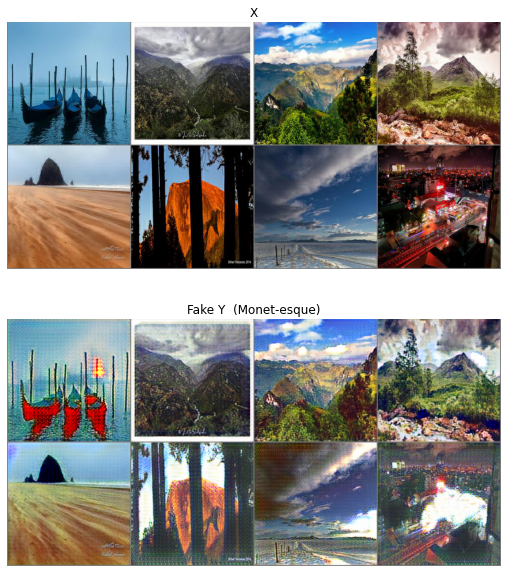

Epoch [  141/  256] | d_total_loss_avg: 0.1478 | g_total_loss: 6.7126
Epoch [  142/  256] | d_total_loss_avg: 0.1591 | g_total_loss: 6.8198
Epoch [  143/  256] | d_total_loss_avg: 0.1666 | g_total_loss: 6.6762
Epoch [  144/  256] | d_total_loss_avg: 0.1994 | g_total_loss: 6.8412
Epoch [  145/  256] | d_total_loss_avg: 0.1302 | g_total_loss: 6.6604
Epoch [  146/  256] | d_total_loss_avg: 0.2103 | g_total_loss: 6.6979
Epoch [  147/  256] | d_total_loss_avg: 0.1993 | g_total_loss: 6.6466
Epoch [  148/  256] | d_total_loss_avg: 0.1377 | g_total_loss: 6.5776
Epoch [  149/  256] | d_total_loss_avg: 0.1468 | g_total_loss: 6.7999
Epoch [  150/  256] | d_total_loss_avg: 0.1380 | g_total_loss: 6.9795


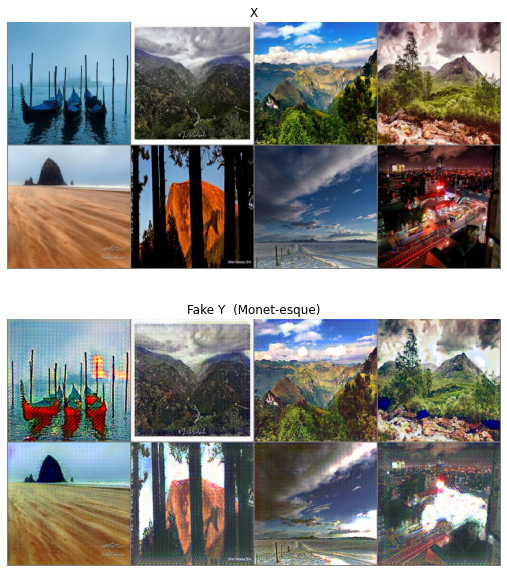

Epoch [  151/  256] | d_total_loss_avg: 0.1635 | g_total_loss: 6.7491
Epoch [  152/  256] | d_total_loss_avg: 0.1517 | g_total_loss: 6.6178
Epoch [  153/  256] | d_total_loss_avg: 0.1429 | g_total_loss: 6.7418
Epoch [  154/  256] | d_total_loss_avg: 0.2097 | g_total_loss: 6.6446
Epoch [  155/  256] | d_total_loss_avg: 0.1385 | g_total_loss: 6.6358
Epoch [  156/  256] | d_total_loss_avg: 0.1564 | g_total_loss: 6.7269
Epoch [  157/  256] | d_total_loss_avg: 0.1838 | g_total_loss: 6.6596
Epoch [  158/  256] | d_total_loss_avg: 0.1235 | g_total_loss: 6.6449
Epoch [  159/  256] | d_total_loss_avg: 0.1205 | g_total_loss: 6.7647
Epoch [  160/  256] | d_total_loss_avg: 0.1338 | g_total_loss: 6.7650


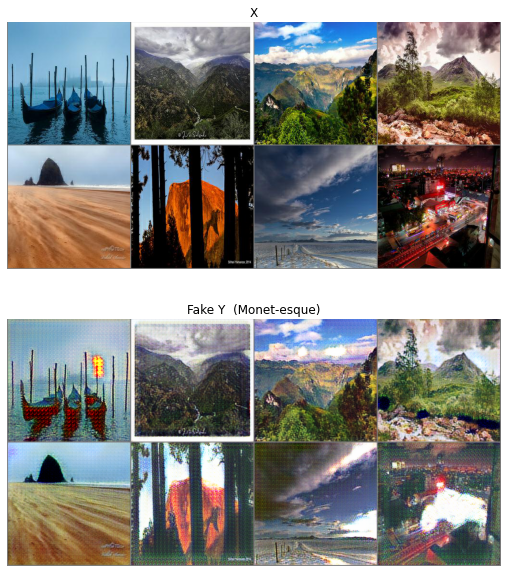

Epoch [  161/  256] | d_total_loss_avg: 0.2295 | g_total_loss: 6.6054
Epoch [  162/  256] | d_total_loss_avg: 0.1292 | g_total_loss: 6.6608
Epoch [  163/  256] | d_total_loss_avg: 0.1652 | g_total_loss: 6.6720
Epoch [  164/  256] | d_total_loss_avg: 0.2073 | g_total_loss: 6.6092
Epoch [  165/  256] | d_total_loss_avg: 0.1364 | g_total_loss: 6.5029
Epoch [  166/  256] | d_total_loss_avg: 0.1804 | g_total_loss: 6.4909
Epoch [  167/  256] | d_total_loss_avg: 0.1636 | g_total_loss: 6.4927
Epoch [  168/  256] | d_total_loss_avg: 0.1551 | g_total_loss: 6.6042
Epoch [  169/  256] | d_total_loss_avg: 0.1770 | g_total_loss: 6.7235
Epoch [  170/  256] | d_total_loss_avg: 0.1248 | g_total_loss: 6.5587


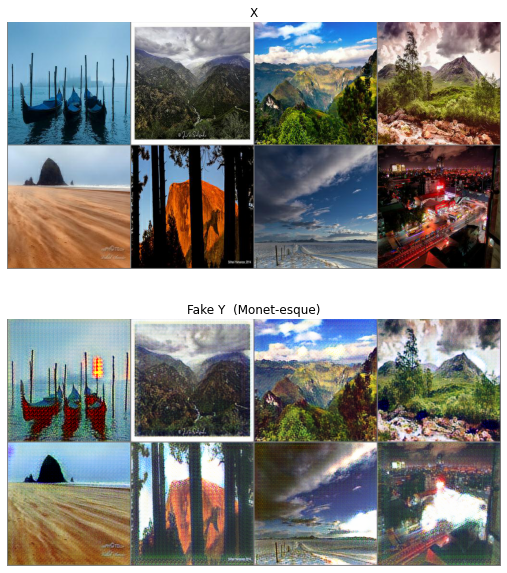

Epoch [  171/  256] | d_total_loss_avg: 0.1441 | g_total_loss: 6.7355
Epoch [  172/  256] | d_total_loss_avg: 0.1216 | g_total_loss: 6.6878
Epoch [  173/  256] | d_total_loss_avg: 0.1974 | g_total_loss: 6.5379
Epoch [  174/  256] | d_total_loss_avg: 0.1234 | g_total_loss: 6.6998
Epoch [  175/  256] | d_total_loss_avg: 0.1733 | g_total_loss: 6.4710
Epoch [  176/  256] | d_total_loss_avg: 0.1339 | g_total_loss: 6.6317
Epoch [  177/  256] | d_total_loss_avg: 0.1289 | g_total_loss: 6.5878
Epoch [  178/  256] | d_total_loss_avg: 0.1486 | g_total_loss: 6.7395
Epoch [  179/  256] | d_total_loss_avg: 0.1536 | g_total_loss: 6.7964
Epoch [  180/  256] | d_total_loss_avg: 0.1447 | g_total_loss: 6.4663


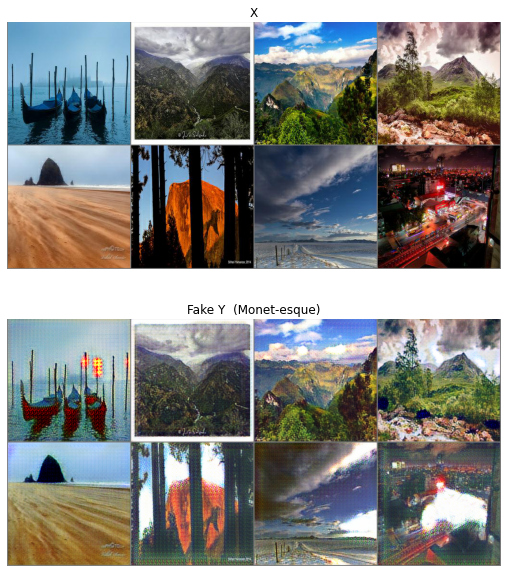

Epoch [  181/  256] | d_total_loss_avg: 0.1776 | g_total_loss: 6.5170
Epoch [  182/  256] | d_total_loss_avg: 0.1091 | g_total_loss: 6.5864
Epoch [  183/  256] | d_total_loss_avg: 0.1237 | g_total_loss: 6.6211
Epoch [  184/  256] | d_total_loss_avg: 0.1963 | g_total_loss: 6.5682
Epoch [  185/  256] | d_total_loss_avg: 0.1357 | g_total_loss: 6.6584
Epoch [  186/  256] | d_total_loss_avg: 0.1216 | g_total_loss: 6.6518
Epoch [  187/  256] | d_total_loss_avg: 0.1486 | g_total_loss: 6.6022
Epoch [  188/  256] | d_total_loss_avg: 0.1933 | g_total_loss: 6.7697
Epoch [  189/  256] | d_total_loss_avg: 0.1616 | g_total_loss: 6.4982
Epoch [  190/  256] | d_total_loss_avg: 0.1325 | g_total_loss: 6.5597


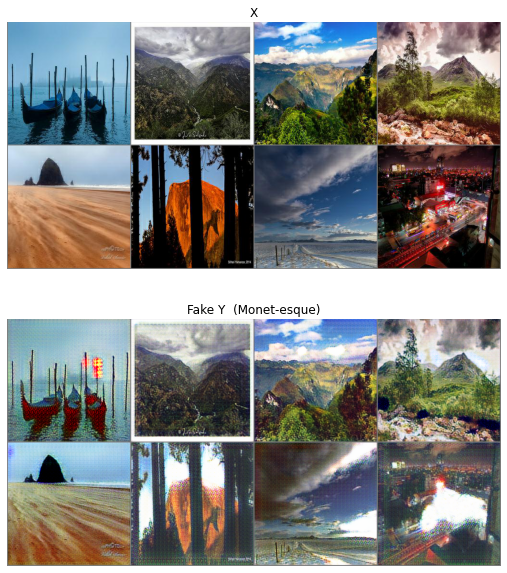

Epoch [  191/  256] | d_total_loss_avg: 0.1223 | g_total_loss: 6.4586
Epoch [  192/  256] | d_total_loss_avg: 0.1199 | g_total_loss: 6.7380
Epoch [  193/  256] | d_total_loss_avg: 0.1470 | g_total_loss: 6.5956
Epoch [  194/  256] | d_total_loss_avg: 0.1622 | g_total_loss: 6.8323
Epoch [  195/  256] | d_total_loss_avg: 0.1284 | g_total_loss: 6.5399
Epoch [  196/  256] | d_total_loss_avg: 0.1835 | g_total_loss: 6.7466
Epoch [  197/  256] | d_total_loss_avg: 0.1448 | g_total_loss: 6.5260
Epoch [  198/  256] | d_total_loss_avg: 0.1214 | g_total_loss: 6.3497
Epoch [  199/  256] | d_total_loss_avg: 0.1468 | g_total_loss: 6.5457
Epoch [  200/  256] | d_total_loss_avg: 0.1318 | g_total_loss: 6.3653


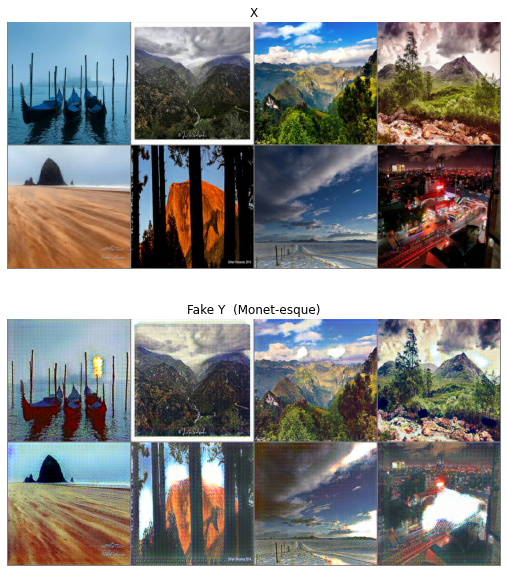

Epoch [  201/  256] | d_total_loss_avg: 0.1814 | g_total_loss: 6.6973
Epoch [  202/  256] | d_total_loss_avg: 0.1263 | g_total_loss: 6.4839
Epoch [  203/  256] | d_total_loss_avg: 0.0963 | g_total_loss: 6.4519
Epoch [  204/  256] | d_total_loss_avg: 0.1267 | g_total_loss: 6.5615
Epoch [  205/  256] | d_total_loss_avg: 0.1977 | g_total_loss: 6.6795
Epoch [  206/  256] | d_total_loss_avg: 0.1531 | g_total_loss: 6.4365
Epoch [  207/  256] | d_total_loss_avg: 0.1033 | g_total_loss: 6.6769
Epoch [  208/  256] | d_total_loss_avg: 0.1015 | g_total_loss: 6.5301
Epoch [  209/  256] | d_total_loss_avg: 0.1614 | g_total_loss: 6.6455
Epoch [  210/  256] | d_total_loss_avg: 0.1062 | g_total_loss: 6.5695


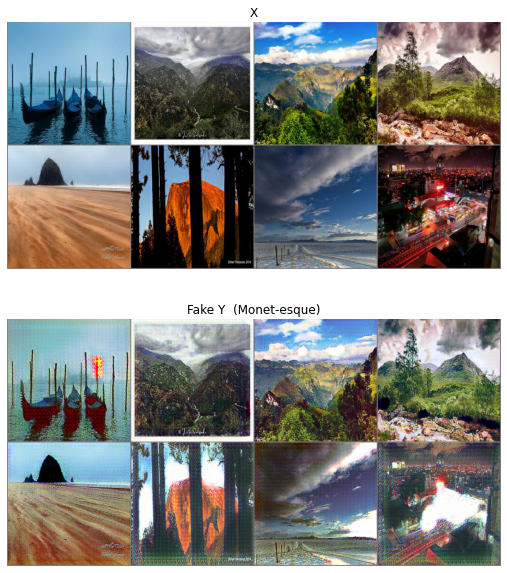

Epoch [  211/  256] | d_total_loss_avg: 0.1186 | g_total_loss: 6.6355
Epoch [  212/  256] | d_total_loss_avg: 0.1505 | g_total_loss: 6.5280
Epoch [  213/  256] | d_total_loss_avg: 0.1539 | g_total_loss: 6.4993
Epoch [  214/  256] | d_total_loss_avg: 0.1138 | g_total_loss: 6.4833
Epoch [  215/  256] | d_total_loss_avg: 0.1059 | g_total_loss: 6.7157
Epoch [  216/  256] | d_total_loss_avg: 0.1216 | g_total_loss: 6.3958
Epoch [  217/  256] | d_total_loss_avg: 0.1461 | g_total_loss: 6.6697
Epoch [  218/  256] | d_total_loss_avg: 0.1425 | g_total_loss: 6.4315
Epoch [  219/  256] | d_total_loss_avg: 0.1658 | g_total_loss: 6.5997
Epoch [  220/  256] | d_total_loss_avg: 0.1408 | g_total_loss: 6.4479


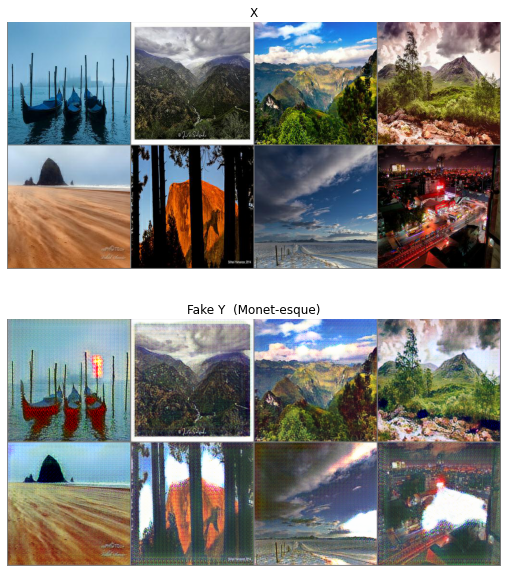

Epoch [  221/  256] | d_total_loss_avg: 0.1185 | g_total_loss: 6.3923
Epoch [  222/  256] | d_total_loss_avg: 0.1488 | g_total_loss: 6.5164
Epoch [  223/  256] | d_total_loss_avg: 0.1554 | g_total_loss: 6.4504
Epoch [  224/  256] | d_total_loss_avg: 0.1064 | g_total_loss: 6.4009
Epoch [  225/  256] | d_total_loss_avg: 0.1237 | g_total_loss: 6.3192
Epoch [  226/  256] | d_total_loss_avg: 0.1577 | g_total_loss: 6.3598
Epoch [  227/  256] | d_total_loss_avg: 0.1025 | g_total_loss: 6.5833
Epoch [  228/  256] | d_total_loss_avg: 0.1214 | g_total_loss: 6.4756
Epoch [  229/  256] | d_total_loss_avg: 0.1225 | g_total_loss: 6.5223
Epoch [  230/  256] | d_total_loss_avg: 0.1121 | g_total_loss: 6.6259


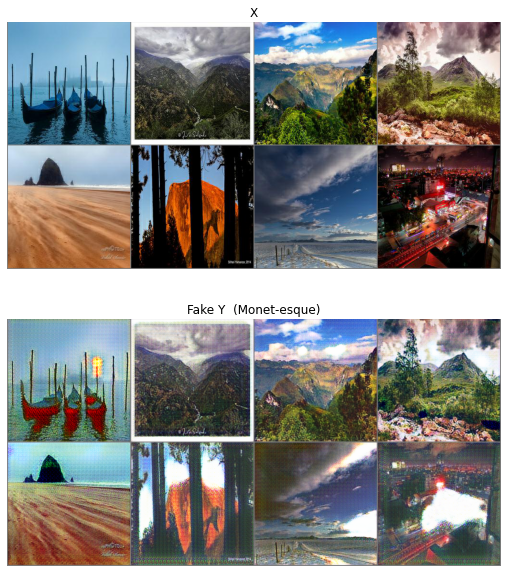

Epoch [  231/  256] | d_total_loss_avg: 0.1922 | g_total_loss: 6.3530
Epoch [  232/  256] | d_total_loss_avg: 0.1219 | g_total_loss: 6.4874
Epoch [  233/  256] | d_total_loss_avg: 0.1208 | g_total_loss: 6.2394
Epoch [  234/  256] | d_total_loss_avg: 0.1077 | g_total_loss: 6.5847
Epoch [  235/  256] | d_total_loss_avg: 0.1763 | g_total_loss: 6.4195
Epoch [  236/  256] | d_total_loss_avg: 0.1113 | g_total_loss: 6.3429
Epoch [  237/  256] | d_total_loss_avg: 0.1155 | g_total_loss: 6.4671
Epoch [  238/  256] | d_total_loss_avg: 0.0839 | g_total_loss: 6.3950
Epoch [  239/  256] | d_total_loss_avg: 0.1588 | g_total_loss: 6.5007
Epoch [  240/  256] | d_total_loss_avg: 0.1338 | g_total_loss: 6.3256


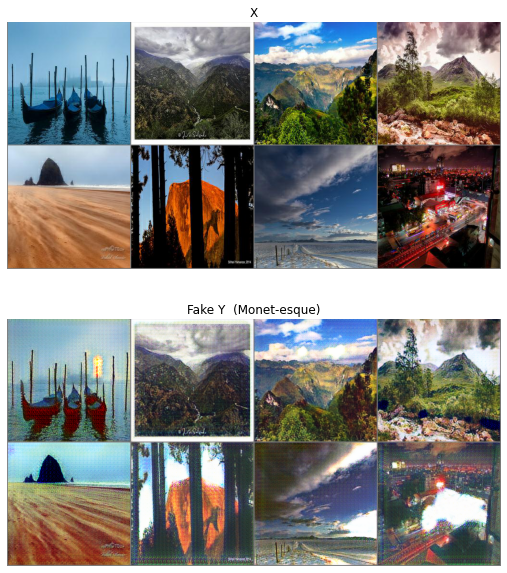

Epoch [  241/  256] | d_total_loss_avg: 0.1009 | g_total_loss: 6.4071
Epoch [  242/  256] | d_total_loss_avg: 0.1106 | g_total_loss: 6.4559
Epoch [  243/  256] | d_total_loss_avg: 0.1444 | g_total_loss: 6.3837
Epoch [  244/  256] | d_total_loss_avg: 0.1489 | g_total_loss: 6.6343
Epoch [  245/  256] | d_total_loss_avg: 0.1108 | g_total_loss: 6.4420
Epoch [  246/  256] | d_total_loss_avg: 0.1385 | g_total_loss: 6.3930
Epoch [  247/  256] | d_total_loss_avg: 0.1125 | g_total_loss: 6.5428
Epoch [  248/  256] | d_total_loss_avg: 0.1264 | g_total_loss: 6.5185
Epoch [  249/  256] | d_total_loss_avg: 0.1047 | g_total_loss: 6.5420
Epoch [  250/  256] | d_total_loss_avg: 0.1096 | g_total_loss: 6.5189


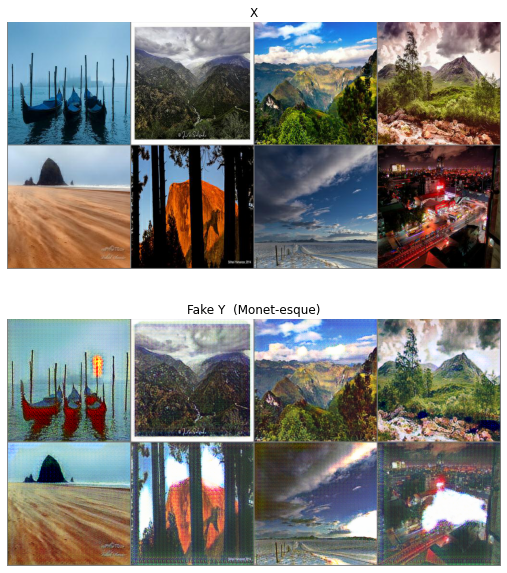

Epoch [  251/  256] | d_total_loss_avg: 0.2013 | g_total_loss: 6.4104
Epoch [  252/  256] | d_total_loss_avg: 0.1187 | g_total_loss: 6.3456
Epoch [  253/  256] | d_total_loss_avg: 0.1017 | g_total_loss: 6.2737
Epoch [  254/  256] | d_total_loss_avg: 0.1246 | g_total_loss: 6.3754
Epoch [  255/  256] | d_total_loss_avg: 0.0979 | g_total_loss: 6.3494
Epoch [  256/  256] | d_total_loss_avg: 0.1160 | g_total_loss: 6.3408


In [28]:
n_epochs = epoch_true * batches_per_epoch
losses = training_loop(dataloader_X, dataloader_Y, test_dataloader_X, test_dataloader_Y, n_epochs=n_epochs)

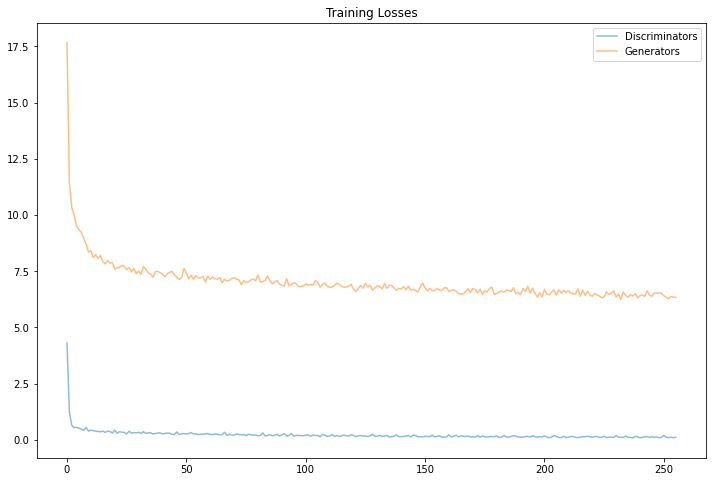

In [29]:
#Plot loss functions over training
fig, ax = plt.subplots(figsize=(12,8))
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminators', alpha=0.5)
plt.plot(losses.T[1], label='Generators', alpha=0.5)
plt.title("Training Losses")
plt.legend()
plt.show()

In [30]:
#Get some fixed data from domains X and Y for sampling. These are images that are held constant throughout training, that allow us to inspect the model's performance.
test_iter_X = iter(test_dataloader_X)
test_iter_Y = iter(test_dataloader_Y)

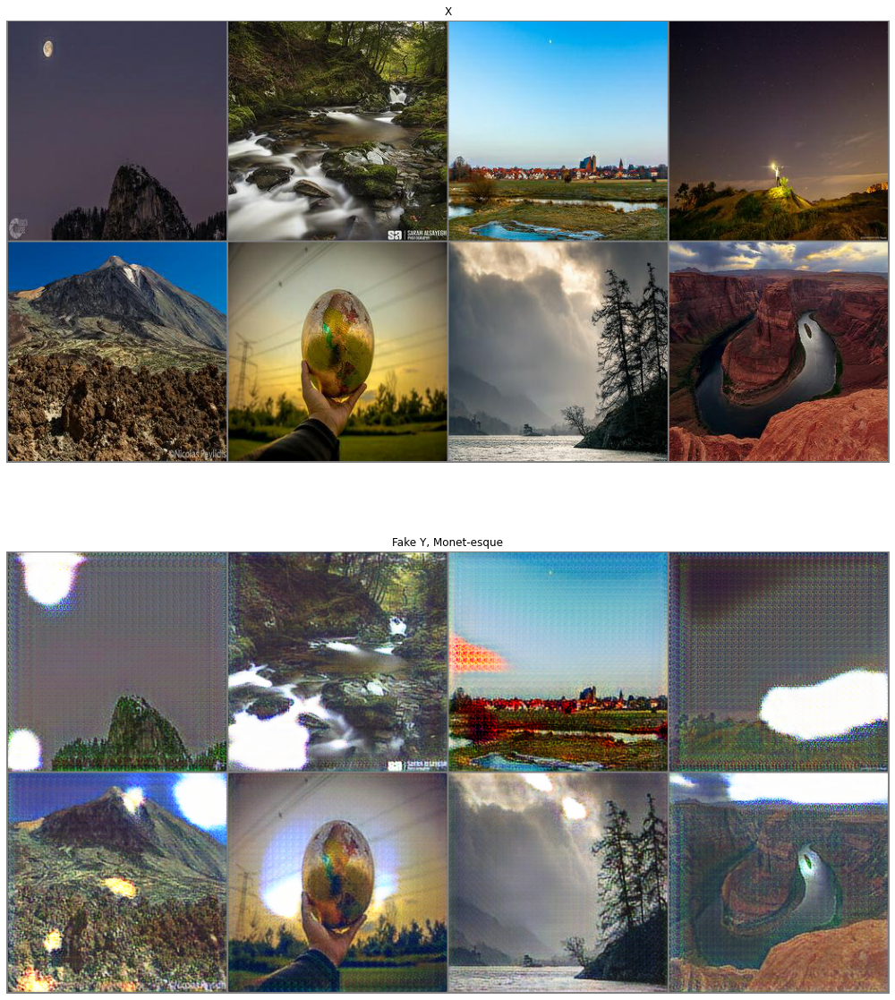

In [31]:
#Sample
fixed_X = test_iter_X.next()
fixed_X = test_iter_X.next()
fixed_X = test_iter_X.next()

#Evaluation
G_XtoY.eval()

mean_=0.5
std_=0.5

#Identify correct device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    
#Create fake pictures for both cycles
fake_Y = G_XtoY(fixed_X.to(device))
    
#Generate grids
grid_x =  make_grid(fixed_X, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
grid_fake_y =  make_grid(fake_Y, nrow=4).permute(1, 2, 0).detach().cpu().numpy() 
    
#Normalize pictures to pixel range rom 0 to 255
X, fake_Y_ = reverse_normalize(grid_x, mean_, std_), reverse_normalize(grid_fake_y, mean_, std_)

#Transformation from X -> Y
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, sharey=True, figsize=(30, 20))
ax1.imshow(X)
ax1.axis('off')
ax1.set_title('X')
ax2.imshow(fake_Y_)
ax2.axis('off')
ax2.set_title('Fake Y, Monet-esque')
plt.show()

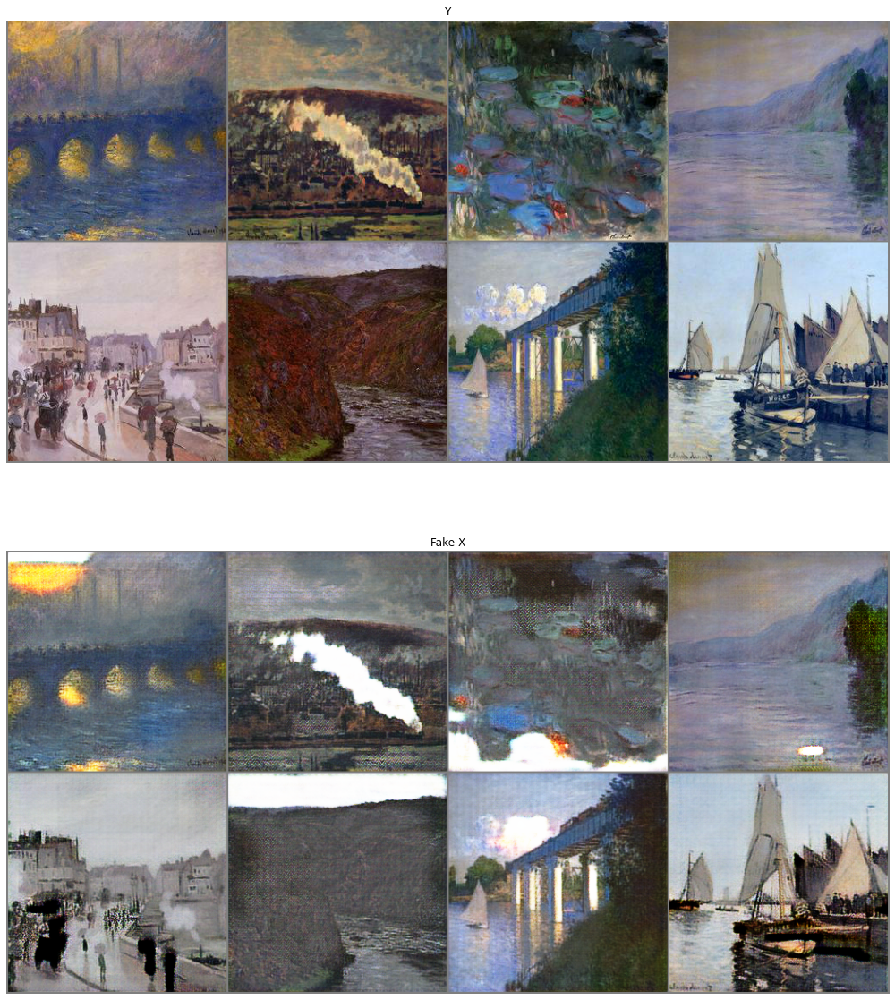

In [32]:
#Sample
fixed_Y = test_iter_Y.next()
fixed_Y = test_iter_Y.next()
fixed_Y = test_iter_Y.next()

#Evaluation
G_YtoX.eval()

mean_=0.5
std_=0.5

#Identify correct device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    
#Create fake pictures for both cycles
fake_X = G_YtoX(fixed_Y.to(device))
    
#Generate grids
grid_y =  make_grid(fixed_Y, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
grid_fake_x =  make_grid(fake_X, nrow=4).permute(1, 2, 0).detach().cpu().numpy()  
    
#Normalize pictures to pixel range rom 0 to 255
Y, fake_X_ = reverse_normalize(grid_y, mean_, std_), reverse_normalize(grid_fake_x, mean_, std_)

#Transformation from Y -> X
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, sharey=True, figsize=(30, 20))
ax1.imshow(Y)
ax1.axis('off')
ax1.set_title('Y')
ax2.imshow(fake_X_)
ax2.axis('off')
ax2.set_title('Fake X')
plt.show()

# Submission

Overall, the notebook contains first steps but requires further enhancements as the __results have not been as good as hoped for__. Please let me know if you spot any errors or have suggestions for improvements. 

In [33]:
#Directory
! mkdir ../images

In [34]:
#Set model to evaluation
G_XtoY.eval()

#Get data loader for final transformation / submission
submit_dataloader = DataLoader(dataset_photo, batch_size=1, shuffle=False, pin_memory=True)
dataiter = iter(submit_dataloader)

#Previous normalization choosen
mean_=0.5 
std_=0.5

#Loop through each picture
for image_idx in range(0, len(submit_dataloader)):
        
    #Get base picture
    fixed_X = dataiter.next()
    
    #Identify correct device
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    
    #Create fake pictures (monet-esque)
    fake_Y = G_XtoY(fixed_X.to(device))
    fake_Y = fake_Y.detach().cpu().numpy()
    fake_Y = reverse_normalize(fake_Y, mean_, std_)
    fake_Y = fake_Y[0].transpose(1, 2, 0)
    fake_Y = np.uint8(fake_Y)
    fake_Y = Image.fromarray(fake_Y)
    #print(fake_Y.shape)
    
    #Save picture
    fake_Y.save("../images/" + str(image_idx) + ".jpg")

#Back to it
G_XtoY.train()

CycleGenerator(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (res_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      )
      (conv2): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): InstanceNorm2d(256, eps=1e-05, momentu

In [35]:
import shutil
shutil.make_archive("/kaggle/working/images", 'zip', "/kaggle/images")
#shutil.rmtree('../images')

'/kaggle/working/images.zip'